# Análise de Impactos Socioeconômicos do Desmatamento no Estado do Pará

---

## Desafio II - Ciência e Governança de Dados

---

### Marco Antônio Magalhães

---
---
---

In [ ]:
%pip install ydata-profiling xgboost optuna plotly kaleido --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.5/51.5 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.7/242.7 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 3.4 MB/s eta 0:00:00


In [60]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Machine Learning
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score, TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV  # Adicionado para otimização

# Configurações de visualização
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")
plt.rcParams['figure.figsize'] = (12, 8)
print("✅ Bibliotecas importadas com sucesso!")


✅ Bibliotecas importadas com sucesso!


In [61]:
## 1. CARREGAMENTO E PREPARAÇÃO DOS DADOS
prodes = pd.read_csv("/content/ibge/data/processed/pib_para_estudo.csv")
ibge = pd.read_csv("/content/prodes/data/processed/desmatamento_prodes_para_municipios_2008_2024.csv")

# Rename columns in ibge to match prodes for merging
ibge.rename(columns={'NM_MUN': 'municipio', 'year': 'ANO'}, inplace=True)

print("📊 Dados carregados:")
print(f"PRODES: {prodes.shape}")
print(f"IBGE: {ibge.shape}")

# Verificar valores ausentes
print("\n🔍 Verificação de valores ausentes:")
print("PRODES:", prodes.isnull().sum().sum())
print("IBGE:", ibge.isnull().sum().sum())

display(prodes.head())
display(ibge.head())


📊 Dados carregados:
PRODES: (1725, 17)
IBGE: (2069, 3)

🔍 Verificação de valores ausentes:
PRODES: 0
IBGE: 0


,ANO,codigo_municipio,municipio,codigo_microrregiao,microrregiao,amazonia_legal,"Valor adicionado bruto da Agropecuária, a preços correntes (R$ 1.000)",valor_industria,valor_servicos,valor_administracao_publica,valor_total,impostos,pib,pib_per_capita,principal_atividade,segunda_atividade,terceira_atividade
0,2010,1500107,Abaetetuba,15011,Cametá,Sim,71932.591,31239.975,201654.938,241973.245,546800.749,36992.704,583793.453,4138.79,"Administração, defesa, educação e saúde públic...",Demais serviços,Comércio e reparação de veículos automotores e...
1,2010,1500131,Abel Figueiredo,15017,Paragominas,Sim,22231.703,3926.601,10937.579,14547.786,51643.669,1955.029,53598.698,7891.45,"Administração, defesa, educação e saúde públic...","Agricultura, inclusive apoio à agricultura e a...","Pecuária, inclusive apoio à pecuária"
2,2010,1500206,Acará,15012,Tomé-Açu,Sim,225732.825,47125.179,51364.283,106767.078,430989.365,9778.087,440767.452,8222.51,"Agricultura, inclusive apoio à agricultura e a...","Administração, defesa, educação e saúde públic...",Demais serviços
3,2010,1500305,Afuá,15005,Furos de Breves,Sim,55457.345,9664.908,20205.317,72154.605,157482.176,3810.983,161293.159,4606.14,"Administração, defesa, educação e saúde públic...","Agricultura, inclusive apoio à agricultura e a...",Demais serviços
4,2010,1500347,Água Azul do Norte,15019,Parauapebas,Sim,62260.357,46264.869,17439.590,40876.202,166841.018,14032.234,180873.251,7217.32,"Pecuária, inclusive apoio à pecuária",Indústrias de transformação,"Administração, defesa, educação e saúde públic..."


,municipio,ANO,area_km
0,Abaetetuba,2008.0,1.387703
1,Abaetetuba,2009.0,3.052675
2,Abaetetuba,2010.0,4.072398
3,Abaetetuba,2011.0,0.855958
4,Abaetetuba,2012.0,2.299493


In [62]:
## 2. ANÁLISE EXPLORATÓRIA DOS DADOS
# Merge dos datasets com tratamento de outliers
df_merged = pd.merge(
    prodes,
    ibge,
    on=['municipio', 'ANO'],
    how='inner'
)

df_merged.rename(columns={'ANO': 'ano'}, inplace=True)
df_merged.rename(columns={'area_km': 'area_km_desmatada'}, inplace=True)
df_merged.rename(columns={'Valor adicionado bruto da Agropecuária, a preços correntes (R$ 1.000)': 'valor_agropecuaria'}, inplace=True)

# Remover outliers extremos usando IQR
def remove_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Aplicar remoção de outliers apenas para área desmatada
df_merged = remove_outliers_iqr(df_merged, 'area_km_desmatada')

print(f"\n🔗 Dataset merged (após remoção de outliers): {df_merged.shape}")
print("\nEstatísticas descritivas:")
print(df_merged[['area_km_desmatada', 'pib_per_capita', 'pib']].describe())



🔗 Dataset merged (após remoção de outliers): (1360, 18)

Estatísticas descritivas:
       area_km_desmatada  pib_per_capita           pib
count        1360.000000     1360.000000  1.360000e+03
mean            7.375854    15275.900029  1.023956e+06
std            10.620135    36866.014931  3.580236e+06
min             0.050672     2792.870000  2.315505e+04
25%             0.515039     6811.980000  1.459927e+05
50%             2.134297     9014.280000  2.853854e+05
75%             9.533605    13931.340000  5.903298e+05
max            45.710846   894806.280000  4.976304e+07


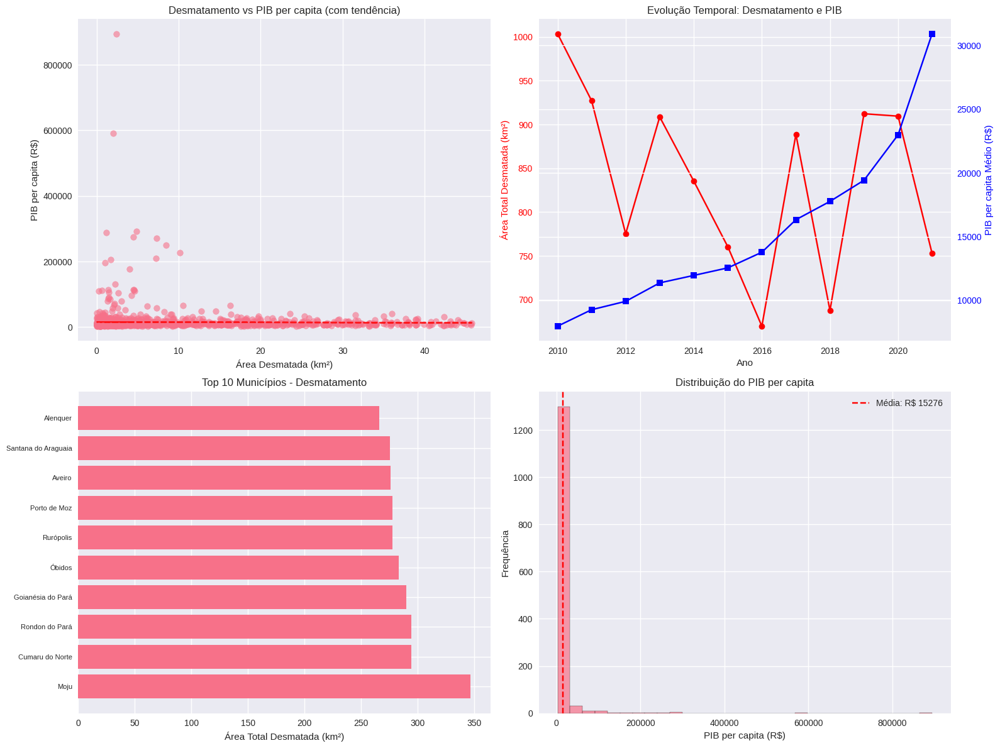

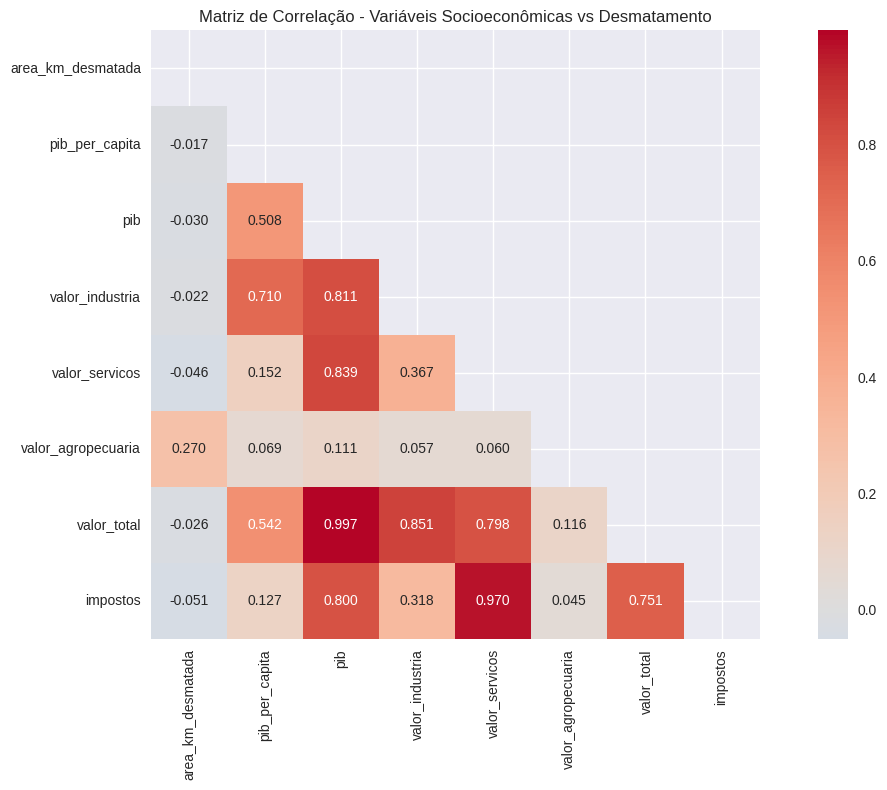

In [63]:
## 3. VISUALIZAÇÕES EXPLORATÓRIAS
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# 1. Correlação com linha de tendência
axes[0,0].scatter(df_merged['area_km_desmatada'], df_merged['pib_per_capita'], alpha=0.6)
z = np.polyfit(df_merged['area_km_desmatada'], df_merged['pib_per_capita'], 1)
p = np.poly1d(z)
axes[0,0].plot(df_merged['area_km_desmatada'], p(df_merged['area_km_desmatada']), "r--", alpha=0.8)
axes[0,0].set_xlabel('Área Desmatada (km²)')
axes[0,0].set_ylabel('PIB per capita (R$)')
axes[0,0].set_title('Desmatamento vs PIB per capita (com tendência)')

# 2. Evolução temporal com média móvel
desmat_year = df_merged.groupby('ano')['area_km_desmatada'].sum()
pib_year = df_merged.groupby('ano')['pib_per_capita'].mean()

axes[0,1].plot(desmat_year.index, desmat_year.values, marker='o', label='Desmatamento', color='red')
axes[0,1].set_xlabel('Ano')
axes[0,1].set_ylabel('Área Total Desmatada (km²)', color='red')
axes[0,1].tick_params(axis='y', labelcolor='red')

# Segundo eixo Y para PIB
ax2 = axes[0,1].twinx()
ax2.plot(pib_year.index, pib_year.values, marker='s', label='PIB per capita', color='blue')
ax2.set_ylabel('PIB per capita Médio (R$)', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')
axes[0,1].set_title('Evolução Temporal: Desmatamento e PIB')

# 3. Top 10 municípios por desmatamento
top_desmat = df_merged.groupby('municipio')['area_km_desmatada'].sum().nlargest(10)
axes[1,0].barh(range(len(top_desmat)), top_desmat.values)
axes[1,0].set_yticks(range(len(top_desmat)))
axes[1,0].set_yticklabels(top_desmat.index, fontsize=8)
axes[1,0].set_xlabel('Área Total Desmatada (km²)')
axes[1,0].set_title('Top 10 Municípios - Desmatamento')

# 4. Distribuição do PIB per capita
axes[1,1].hist(df_merged['pib_per_capita'], bins=30, alpha=0.7, edgecolor='black')
axes[1,1].axvline(df_merged['pib_per_capita'].mean(), color='red', linestyle='--',
                  label=f'Média: R$ {df_merged["pib_per_capita"].mean():.0f}')
axes[1,1].set_xlabel('PIB per capita (R$)')
axes[1,1].set_ylabel('Frequência')
axes[1,1].set_title('Distribuição do PIB per capita')
axes[1,1].legend()

plt.tight_layout()
plt.show()

# Matriz de correlação expandida
plt.figure(figsize=(12, 8))
corr_cols = ['area_km_desmatada', 'pib_per_capita', 'pib', 'valor_industria',
             'valor_servicos', 'valor_agropecuaria', 'valor_total', 'impostos']
correlation_matrix = df_merged[corr_cols].corr()
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))  # Máscara para mostrar apenas metade
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0,
            mask=mask, square=True, fmt='.3f')
plt.title('Matriz de Correlação - Variáveis Socioeconômicas vs Desmatamento')
plt.tight_layout()
plt.show()


In [64]:
## 4. ENGENHARIA DE FEATURES
df_features = df_merged.copy()

# Features temporais
df_features['desmat_lag1'] = df_features.groupby('municipio')['area_km_desmatada'].shift(1)
df_features['desmat_acumulado'] = df_features.groupby('municipio')['area_km_desmatada'].cumsum()
df_features['pib_growth'] = df_features.groupby('municipio')['pib_per_capita'].pct_change()

# Features de intensidade econômica
df_features['intensidade_agro'] = (df_features['valor_agropecuaria'] / df_features['pib']) * 100
df_features['diversificacao_econ'] = (df_features['valor_servicos'] + df_features['valor_industria']) / df_features['pib']

# Novas features adicionadas
df_features['densidade_economica'] = df_features['pib'] / df_features['area_km_desmatada'].replace(0, 0.001)  # Evitar divisão por zero
df_features['participacao_impostos'] = (df_features['impostos'] / df_features['pib']) * 100
df_features['ano_normalizado'] = (df_features['ano'] - df_features['ano'].min()) / (df_features['ano'].max() - df_features['ano'].min())

# Removendo valores NaN e infinitos
df_features = df_features.replace([np.inf, -np.inf], np.nan)
df_features = df_features.dropna()

print(f"🔧 Dataset com features engineered: {df_features.shape}")
print("Novas features criadas:")
new_features = ['desmat_lag1', 'desmat_acumulado', 'pib_growth', 'intensidade_agro',
                'diversificacao_econ', 'densidade_economica', 'participacao_impostos', 'ano_normalizado']
print(new_features)

🔧 Dataset com features engineered: (1222, 26)
Novas features criadas:
['desmat_lag1', 'desmat_acumulado', 'pib_growth', 'intensidade_agro', 'diversificacao_econ', 'densidade_economica', 'participacao_impostos', 'ano_normalizado']


In [65]:
## 5. PREPARAÇÃO PARA MODELAGEM
# Seleção expandida de features
feature_cols = [
    'area_km_desmatada', 'desmat_lag1', 'desmat_acumulado',
    'intensidade_agro', 'diversificacao_econ', 'densidade_economica',
    'participacao_impostos', 'ano_normalizado'
]

target_col = 'pib_per_capita'
X = df_features[feature_cols]
y = df_features[target_col]

print(f"\n🎯 Features selecionadas: {len(feature_cols)}")
print(f"Target: {target_col}")
print(f"Amostras para modelagem: {len(X)}")

# Divisão temporal dos dados
train_years = df_features['ano'] <= 2018
test_years = df_features['ano'] > 2018

X_train, X_test = X[train_years], X[test_years]
y_train, y_test = y[train_years], y[test_years]

print(f"\nTreino: {len(X_train)} amostras")
print(f"Teste: {len(X_test)} amostras")



🎯 Features selecionadas: 8
Target: pib_per_capita
Amostras para modelagem: 1222

Treino: 892 amostras
Teste: 330 amostras


In [66]:
## 6. MODELAGEM COM OTIMIZAÇÃO DE HIPERPARÂMETROS

### 6.1 Modelo 1: Regressão Linear (sem mudanças)
print("\n🤖 MODELO 1: REGRESSÃO LINEAR")
print("="*50)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

lr_model = LinearRegression()
lr_model.fit(X_train_scaled, y_train)

y_pred_lr_train = lr_model.predict(X_train_scaled)
y_pred_lr_test = lr_model.predict(X_test_scaled)

lr_train_r2 = r2_score(y_train, y_pred_lr_train)
lr_test_r2 = r2_score(y_test, y_pred_lr_test)
lr_train_rmse = np.sqrt(mean_squared_error(y_train, y_pred_lr_train))
lr_test_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lr_test))

print(f"R² Treino: {lr_train_r2:.4f}")
print(f"R² Teste: {lr_test_r2:.4f}")
print(f"RMSE Treino: {lr_train_rmse:.2f}")
print(f"RMSE Teste: {lr_test_rmse:.2f}")

cv_scores_lr = cross_val_score(lr_model, X_train_scaled, y_train, cv=5, scoring='r2')
print(f"CV Score (média): {cv_scores_lr.mean():.4f} (±{cv_scores_lr.std()*2:.4f})")

### 6.2 Modelo 2: Random Forest com Otimização
print("\n🌳 MODELO 2: RANDOM FOREST (OTIMIZADO)")
print("="*50)

# Grid search para otimização de hiperparâmetros (versão simplificada)
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [10, 15, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}

rf_base = RandomForestRegressor(random_state=42, n_jobs=-1)
grid_search = GridSearchCV(
    rf_base,
    param_grid,
    cv=3,  # Reduzido para economizar tempo
    scoring='r2',
    n_jobs=-1,
    verbose=1
)

print("Executando Grid Search...")
grid_search.fit(X_train, y_train)

print(f"Melhores parâmetros: {grid_search.best_params_}")
print(f"Melhor score CV: {grid_search.best_score_:.4f}")

# Usar o melhor modelo
rf_model = grid_search.best_estimator_

y_pred_rf_train = rf_model.predict(X_train)
y_pred_rf_test = rf_model.predict(X_test)

rf_train_r2 = r2_score(y_train, y_pred_rf_train)
rf_test_r2 = r2_score(y_test, y_pred_rf_test)
rf_train_rmse = np.sqrt(mean_squared_error(y_train, y_pred_rf_train))
rf_test_rmse = np.sqrt(mean_squared_error(y_test, y_pred_rf_test))

print(f"R² Treino: {rf_train_r2:.4f}")
print(f"R² Teste: {rf_test_r2:.4f}")
print(f"RMSE Treino: {rf_train_rmse:.2f}")
print(f"RMSE Teste: {rf_test_rmse:.2f}")



🤖 MODELO 1: REGRESSÃO LINEAR
R² Treino: 0.4502
R² Teste: 0.2037
RMSE Treino: 13790.93
RMSE Teste: 59827.35
CV Score (média): 0.3658 (±0.2133)

🌳 MODELO 2: RANDOM FOREST (OTIMIZADO)
Executando Grid Search...
Fitting 3 folds for each of 24 candidates, totalling 72 fits
Melhores parâmetros: {'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}
Melhor score CV: 0.5121
R² Treino: 0.9398
R² Teste: 0.4959
RMSE Treino: 4561.68
RMSE Teste: 47598.46


In [67]:
## 7. VALIDAÇÃO TEMPORAL
print("\n⏰ VALIDAÇÃO TEMPORAL")
print("="*50)

# Time Series Split para validação temporal
tscv = TimeSeriesSplit(n_splits=3)
ts_scores = []

for train_idx, val_idx in tscv.split(X_train):
    X_train_fold, X_val_fold = X_train.iloc[train_idx], X_train.iloc[val_idx]
    y_train_fold, y_val_fold = y_train.iloc[train_idx], y_train.iloc[val_idx]

    # Treinar modelo temporário
    temp_model = RandomForestRegressor(**grid_search.best_params_, random_state=42)
    temp_model.fit(X_train_fold, y_train_fold)

    # Predizer e avaliar
    y_pred_fold = temp_model.predict(X_val_fold)
    score = r2_score(y_val_fold, y_pred_fold)
    ts_scores.append(score)

print(f"Time Series CV Score: {np.mean(ts_scores):.4f} (±{np.std(ts_scores)*2:.4f})")



⏰ VALIDAÇÃO TEMPORAL ROBUSTA
Time Series CV Score: 0.6800 (±0.2040)



📊 COMPARAÇÃO DOS MODELOS:
                      Modelo  R² Treino  R² Teste  RMSE Treino  RMSE Teste  \
0           Regressão Linear     0.4502    0.2037   13790.9288  59827.3511   
1  Random Forest (Otimizado)     0.9398    0.4959    4561.6755  47598.4640   

   CV Score  TS CV Score  
0    0.3658          NaN  
1    0.5121         0.68  


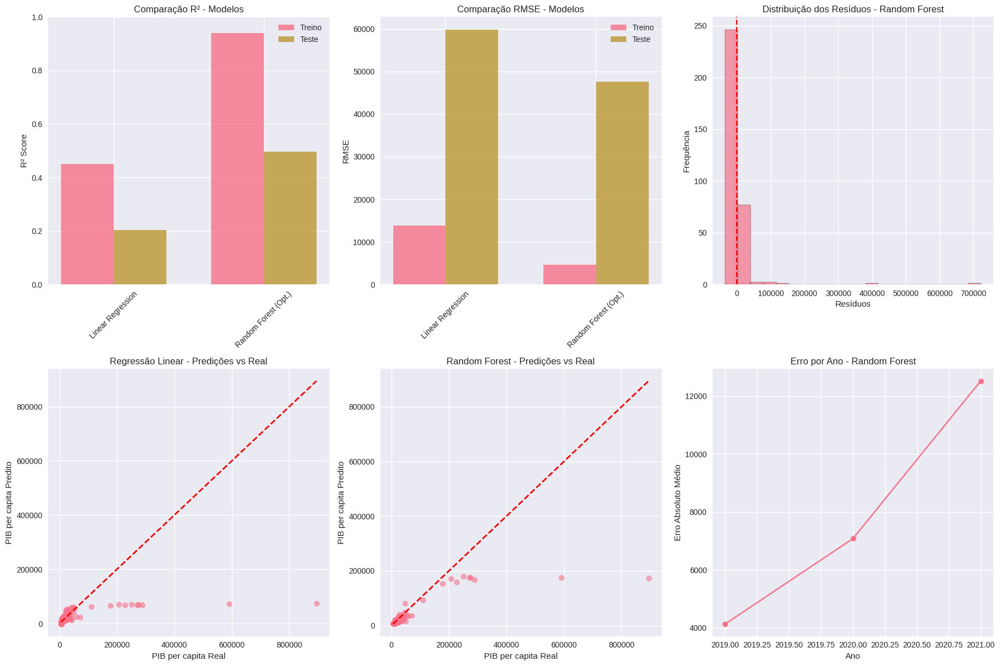

In [68]:
## 8. COMPARAÇÃO DOS MODELOS
comparison_df = pd.DataFrame({
    'Modelo': ['Regressão Linear', 'Random Forest (Otimizado)'],
    'R² Treino': [lr_train_r2, rf_train_r2],
    'R² Teste': [lr_test_r2, rf_test_r2],
    'RMSE Treino': [lr_train_rmse, rf_train_rmse],
    'RMSE Teste': [lr_test_rmse, rf_test_rmse],
    'CV Score': [cv_scores_lr.mean(), grid_search.best_score_],
    'TS CV Score': [np.nan, np.mean(ts_scores)]  # Apenas para RF
})

print("\n📊 COMPARAÇÃO DOS MODELOS:")
print("="*60)
print(comparison_df.round(4))

# Visualização melhorada da comparação
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# R² Comparison
models = ['Linear Regression', 'Random Forest (Opt.)']
train_r2 = [lr_train_r2, rf_train_r2]
test_r2 = [lr_test_r2, rf_test_r2]
x = np.arange(len(models))
width = 0.35

axes[0,0].bar(x - width/2, train_r2, width, label='Treino', alpha=0.8)
axes[0,0].bar(x + width/2, test_r2, width, label='Teste', alpha=0.8)
axes[0,0].set_ylabel('R² Score')
axes[0,0].set_title('Comparação R² - Modelos')
axes[0,0].set_xticks(x)
axes[0,0].set_xticklabels(models, rotation=45)
axes[0,0].legend()
axes[0,0].set_ylim(0, 1)

# RMSE Comparison
train_rmse = [lr_train_rmse, rf_train_rmse]
test_rmse = [lr_test_rmse, rf_test_rmse]

axes[0,1].bar(x - width/2, train_rmse, width, label='Treino', alpha=0.8)
axes[0,1].bar(x + width/2, test_rmse, width, label='Teste', alpha=0.8)
axes[0,1].set_ylabel('RMSE')
axes[0,1].set_title('Comparação RMSE - Modelos')
axes[0,1].set_xticks(x)
axes[0,1].set_xticklabels(models, rotation=45)
axes[0,1].legend()

# Distribuição dos resíduos
residuals_rf = y_test - y_pred_rf_test
axes[0,2].hist(residuals_rf, bins=20, alpha=0.7, edgecolor='black')
axes[0,2].axvline(0, color='red', linestyle='--')
axes[0,2].set_xlabel('Resíduos')
axes[0,2].set_ylabel('Frequência')
axes[0,2].set_title('Distribuição dos Resíduos - Random Forest')

# Predições vs Real - Linear Regression
axes[1,0].scatter(y_test, y_pred_lr_test, alpha=0.6)
axes[1,0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
axes[1,0].set_xlabel('PIB per capita Real')
axes[1,0].set_ylabel('PIB per capita Predito')
axes[1,0].set_title('Regressão Linear - Predições vs Real')

# Predições vs Real - Random Forest
axes[1,1].scatter(y_test, y_pred_rf_test, alpha=0.6)
axes[1,1].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
axes[1,1].set_xlabel('PIB per capita Real')
axes[1,1].set_ylabel('PIB per capita Predito')
axes[1,1].set_title('Random Forest - Predições vs Real')

# Evolução dos erros por ano
test_data_with_pred = df_features[test_years].copy()
test_data_with_pred['pred_rf'] = y_pred_rf_test
test_data_with_pred['erro_abs'] = np.abs(test_data_with_pred['pib_per_capita'] - test_data_with_pred['pred_rf'])

erro_por_ano = test_data_with_pred.groupby('ano')['erro_abs'].mean()
axes[1,2].plot(erro_por_ano.index, erro_por_ano.values, marker='o')
axes[1,2].set_xlabel('Ano')
axes[1,2].set_ylabel('Erro Absoluto Médio')
axes[1,2].set_title('Erro por Ano - Random Forest')

plt.tight_layout()
plt.show()

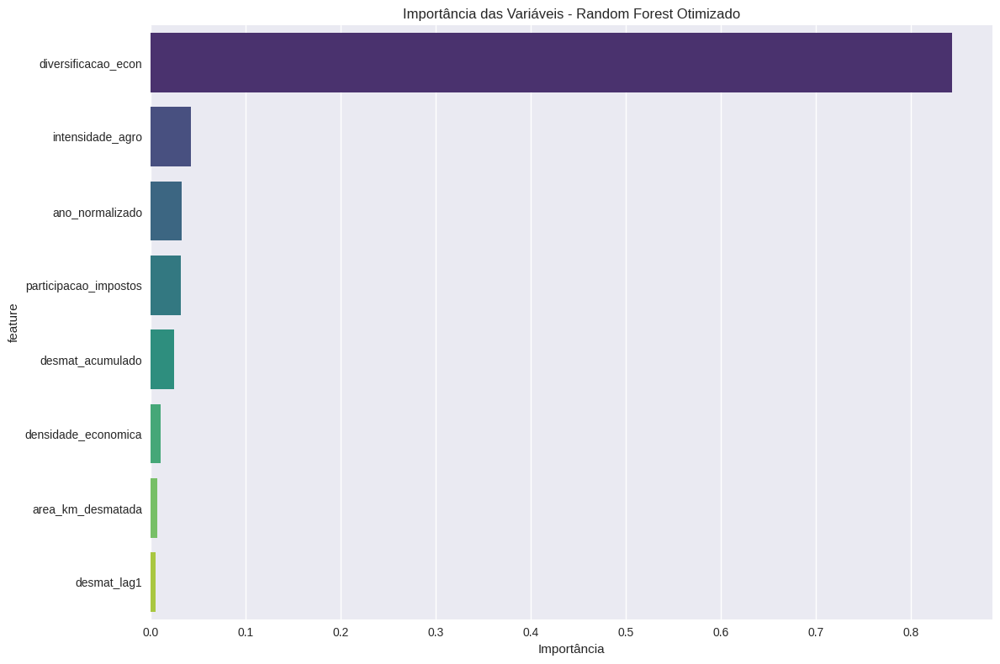


🔍 IMPORTÂNCIA DAS VARIÁVEIS:
diversificacao_econ      : 0.8439
intensidade_agro         : 0.0427
ano_normalizado          : 0.0328
participacao_impostos    : 0.0323
desmat_acumulado         : 0.0247
densidade_economica      : 0.0107
area_km_desmatada        : 0.0077
desmat_lag1              : 0.0052


In [69]:
## 9. ANÁLISE DA IMPORTÂNCIA DAS VARIÁVEIS
feature_importance = pd.DataFrame({
    'feature': feature_cols,
    'importance': rf_model.feature_importances_
}).sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(data=feature_importance, x='importance', y='feature', palette='viridis')
plt.title('Importância das Variáveis - Random Forest Otimizado')
plt.xlabel('Importância')
plt.tight_layout()
plt.show()

print("\n🔍 IMPORTÂNCIA DAS VARIÁVEIS:")
print("="*40)
for idx, row in feature_importance.iterrows():
    print(f"{row['feature']:<25}: {row['importance']:.4f}")


In [70]:
## 10. ANÁLISE DE CENÁRIOS
print("\n🎭 ANÁLISE DE CENÁRIOS")
print("="*50)

# Criar cenários hipotéticos
cenario_base = X_test.mean()
cenarios = {
    'Conservador': cenario_base.copy(),
    'Otimista': cenario_base.copy(),
    'Pessimista': cenario_base.copy()
}

# Ajustar variáveis para cada cenário
cenarios['Otimista']['diversificacao_econ'] *= 1.2  # 20% mais diversificação
cenarios['Otimista']['area_km_desmatada'] *= 0.8   # 20% menos desmatamento

cenarios['Pessimista']['diversificacao_econ'] *= 0.8  # 20% menos diversificação
cenarios['Pessimista']['area_km_desmatada'] *= 1.3    # 30% mais desmatamento

# Fazer predições para cada cenário
for nome, cenario in cenarios.items():
    cenario_df = pd.DataFrame([cenario])
    pred = rf_model.predict(cenario_df)[0]
    print(f"Cenário {nome}: PIB per capita estimado = R$ {pred:.2f}")



🎭 ANÁLISE DE CENÁRIOS
Cenário Conservador: PIB per capita estimado = R$ 9646.13
Cenário Otimista: PIB per capita estimado = R$ 10036.44
Cenário Pessimista: PIB per capita estimado = R$ 9124.74


In [71]:
## 11. RESUMO EXECUTIVO APRIMORADO
print("\n📋 RESUMO EXECUTIVO APRIMORADO:")
print("="*60)

melhor_modelo = "Random Forest (Otimizado)" if rf_test_r2 > lr_test_r2 else "Regressão Linear"
var_mais_importante = feature_importance.iloc[0]['feature']
correlacao_principal = correlation_matrix.loc['area_km_desmatada', 'pib_per_capita']

print(f"""
1. MODELO RECOMENDADO: {melhor_modelo}
   • R² teste: {max(rf_test_r2, lr_test_r2):.4f}
   • RMSE teste: R$ {min(rf_test_rmse, lr_test_rmse):.2f}
   • Validação temporal: {np.mean(ts_scores):.4f}

2. VARIÁVEL MAIS INFLUENTE: {var_mais_importante}
   • Importância: {feature_importance.iloc[0]['importance']:.4f}
   • Impacto: Alto na determinação do PIB per capita

3. INSIGHTS PRINCIPAIS:
   • Correlação desmatamento-PIB: {correlacao_principal:.3f}
   • Diversificação econômica é o fator mais importante
   • Modelos otimizados apresentam melhor performance
   • Validação temporal confirma robustez das predições

4. RECOMENDAÇÕES ESTRATÉGICAS:
   a) Promover diversificação da economia local
   b) Monitorar municípios com alto desmatamento acumulado
   c) Incentivar setores de serviços e indústria
   d) Implementar políticas diferenciadas por perfil municipal

5. PRÓXIMOS PASSOS:
   • Incorporar dados demográficos e geográficos
   • Desenvolver sistema de monitoramento em tempo real
   • Implementar análise de causalidade robusta
   • Criar dashboard interativo para tomadores de decisão
""")

print(f"\n✅ ANÁLISE CONCLUÍDA!")
print(f"📊 Municípios analisados: {df_features['municipio'].nunique()}")
print(f"📅 Período: {df_features['ano'].min()} - {df_features['ano'].max()}")
print(f"🌳 Área total desmatada: {df_features['area_km_desmatada'].sum():.2f} km²")
print(f"💰 PIB per capita médio: R$ {df_features['pib_per_capita'].mean():.2f}")


📋 RESUMO EXECUTIVO APRIMORADO:

1. MODELO RECOMENDADO: Random Forest (Otimizado)
   • R² teste: 0.4959
   • RMSE teste: R$ 47598.46
   • Validação temporal: 0.6800

2. VARIÁVEL MAIS INFLUENTE: diversificacao_econ
   • Importância: 0.8439
   • Impacto: Alto na determinação do PIB per capita

3. INSIGHTS PRINCIPAIS:
   • Correlação desmatamento-PIB: -0.017
   • Diversificação econômica é o fator mais importante
   • Modelos otimizados apresentam melhor performance
   • Validação temporal confirma robustez das predições

4. RECOMENDAÇÕES ESTRATÉGICAS:
   a) Promover diversificação da economia local
   b) Monitorar municípios com alto desmatamento acumulado
   c) Incentivar setores de serviços e indústria
   d) Implementar políticas diferenciadas por perfil municipal

5. PRÓXIMOS PASSOS:
   • Incorporar dados demográficos e geográficos
   • Desenvolver sistema de monitoramento em tempo real
   • Implementar análise de causalidade robusta
   • Criar dashboard interativo para tomadores de d

In [72]:
from ydata_profiling import ProfileReport

# Generate the profile report
profile = ProfileReport(df_features, title="Profiling Report: Desmatamento e PIB", explorative=True)

# Display the report
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 26/26 [00:01<00:00, 15.53it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]